In [ ]:
%matplotlib inline

In [ ]:
cd ..  # this is only here as the package is not install yet.

In [56]:
import sim_data as sd
import numpy as np
import mne
from mne.datasets import spm_face, somato, eegbci
from mne.datasets.brainstorm import bst_raw

# Pipeline

For each of the sample datasets the following is done:

* loading data.
* epoching.
* search for the best order of the polynomial.
* simulate data based on the epochs and best order number.
* plot the real data and the simluted data.
* plot the difference between the real and simulated data.

# Preprocessing spm_face

In [ ]:
raw_fname = data_path + '/MEG/spm/SPM_CTF_MEG_example_faces%d_3D.ds'

raw = mne.io.read_raw_ctf(raw_fname % 1, preload=True)  # Take first run
# Here to save memory and time we'll downsample heavily -- this is not
# advised for real data as it can effectively jitter events!
raw.resample(120., npad='auto')

picks = mne.pick_types(raw.info, meg="mag", exclude='bads')
raw.filter(1, 30, method='iir')

events = mne.find_events(raw, stim_channel='UPPT001')
event_ids = {"faces": 1, "scrambled": 2}

tmin, tmax = -0.2, 0.6
baseline = None  # no baseline as high-pass is applied
reject = dict(mag=5e-12)

epochs = mne.Epochs(raw, events, event_ids, tmin, tmax,  picks=picks,
                    baseline=baseline, preload=True, reject=reject)

In [ ]:
orders = np.arange(5,20,1)  # The orders to search
mse_res, rmse_res, r2_res, aic_res, loglik_res = sd.search_for_best_order(epochs,
                                                                          orders=orders, 
                                                                          plot=True)

In [ ]:
best_order = orders[np.asarray(mse_res).argmin()]
print(best_order)

In [ ]:
sim_data = sd.make_sim_data(epochs, order=18)

In [ ]:
sim_data.average().plot_joint();
epochs.average().plot_joint();

In [ ]:
diff = mne.combine_evoked([epochs.average(), -sim_data.average()], weights="equal")

In [ ]:
diff.plot_joint();

# Preprocessing somato dataset

In [ ]:
data_path = somato.data_path()
raw_fname = data_path + '/MEG/somato/sef_raw_sss.fif'

# Setup for reading the raw data
raw = mne.io.read_raw_fif(raw_fname)
events = mne.find_events(raw, stim_channel='STI 014')

# picks MEG gradiometers
picks = mne.pick_types(raw.info, meg='grad', eeg=False, eog=True, stim=False)

# Construct Epochs
event_id, tmin, tmax = 1, -1., 3.
baseline = (None, 0)
epochs = mne.Epochs(raw, events, event_id, tmin, tmax, picks=picks,
                    baseline=baseline, reject=dict(grad=4000e-13, eog=350e-6),
                    preload=True)

In [ ]:
orders = np.arange(5, 18, 1)  # The orders to search
mse_res, rmse_res, r2_res, aic_res, loglik_res = sd.search_for_best_order(epochs,
                                                                          orders=orders, 
                                                                          plot=True)

In [ ]:
best_order = orders[np.asarray(mse_res).argmin()]
print(best_order)

In [ ]:
sim_data = sd.make_sim_data(epochs, baseline=(None, -0.1), order=17)

In [ ]:
sim_data.average().plot_joint();
epochs.average().plot_joint();

In [ ]:
diff = mne.combine_evoked([epochs.average(), -sim_data.average()], weights="equal")
diff.plot_joint();

# Preprocessing eegbci dataset

In [ ]:
tmin, tmax = -1., 4.
event_id = dict(hands=2, feet=3)
subject = 1
runs = [6, 10, 14]  # motor imagery: hands vs feet

raw_fnames = eegbci.load_data(subject, runs)
raw_files = [mne.io.read_raw_edf(f, preload=True) for f in raw_fnames]
raw = mne.io.concatenate_raws(raw_files)

# strip channel names of "." characters
raw.rename_channels(lambda x: x.strip('.'))

# Apply band-pass filter
raw.filter(7., 30., fir_design='firwin')

events = mne.find_events(raw, shortest_event=0, stim_channel='STI 014')

picks = mne.pick_types(raw.info, meg=False, eeg=True, stim=False, eog=False,
                   exclude='bads')

# Read epochs (train will be done only between 1 and 2s)
# Testing will be done with a running classifier
epochs = mne.Epochs(raw, events, event_id, tmin, tmax, proj=True, picks=picks,
                baseline=None, preload=True)

In [ ]:
orders = np.arange(5, 28, 1)  # The orders to search
mse_res, rmse_res, r2_res, aic_res, loglik_res = sd.search_for_best_order(epochs,
                                                                          orders=orders, 
                                                                          plot=True)

In [ ]:
best_order = orders[np.asarray(mse_res).argmin()]
print(best_order)

In [ ]:
sim_data = sd.make_sim_data(epochs, baseline=(None, -0.1), order=27)

In [ ]:
sim_data.average().plot();
epochs.average().plot();

In [ ]:
diff = mne.combine_evoked([epochs.average(), -sim_data.average()], weights="equal")
diff.plot();

In [ ]:
epochs

# Preprocessing brainstorm nerve stim dataset

Using default location ~/mne_data for brainstorm...

License
-------
This tutorial dataset (EEG and MRI data) remains a property of the MEG Lab,
McConnell Brain Imaging Center, Montreal Neurological Institute,
McGill University, Canada. Its use and transfer outside the Brainstorm
tutorial, e.g. for research purposes, is prohibited without written consent
from the MEG Lab.

If you reference this dataset in your publications, please:

    1) acknowledge its authors: Elizabeth Bock, Esther Florin, Francois Tadel
       and Sylvain Baillet, and
    2) cite Brainstorm as indicated on the website:
       http://neuroimage.usc.edu/brainstorm

For questions, please contact Francois Tadel (francois.tadel@mcgill.ca).
Agree (y/[n])? y

[........................................] 100.00000 \ (599.3 MB / 599.3 MB)   
Decompressing the archive: /Users/au194693/mne_data/bst_raw.tar.gz
(please be patient, this can take some time)
Opening raw data file /Users/au194693/mne_data/MNE-brainstorm-data/bst_ra

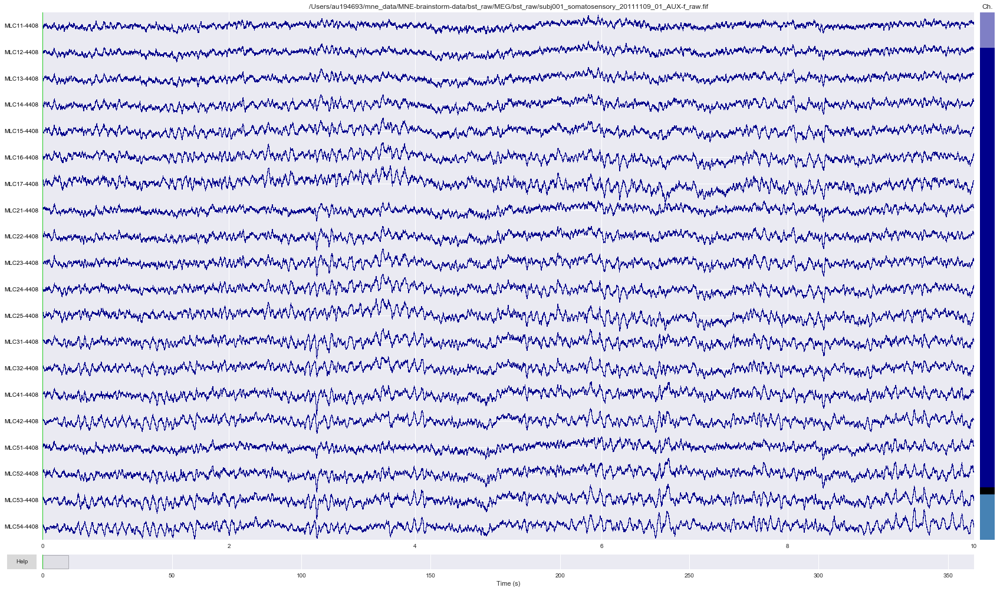

Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but hasn't been applied yet. Use the .apply_proj() method function to apply projections.
Setting up band-stop filter
fir_design defaults to "firwin2" in 0.15 but will change to "firwin" in 0.16, set it explicitly to avoid this warning.
Filter length of 15840 samples (13.200 sec) selected


<ipython-input-57-c3bc671b51da>:15: DeprecationWarning: fir_design defaults to "firwin2" in 0.15 but will change to "firwin" in 0.16, set it explicitly to avoid this warning.
  raw.notch_filter(np.arange(60, 181, 60))


200 events found
Events id: [1 2]
102 matching events found
1 projection items activated


In [57]:
tmin, tmax, event_id = -0.1, 0.3, 2  # take right-hand somato
reject = dict(mag=4e-12, eog=250e-6)

data_path = bst_raw.data_path()

raw_fname = data_path + '/MEG/bst_raw/' + \
                        'subj001_somatosensory_20111109_01_AUX-f_raw.fif'
raw = mne.io.read_raw_fif(raw_fname, preload=True)
raw.plot()

# set EOG channel
raw.set_channel_types({'EEG058': 'eog'})
raw.set_eeg_reference()

# show power line interference and remove it
raw.notch_filter(np.arange(60, 181, 60))

events = mne.find_events(raw, stim_channel='UPPT001')

# pick MEG channels
picks = mne.pick_types(raw.info, meg=True, eeg=False, stim=False, eog=True,
                       exclude='bads')

# Compute epochs
epochs = mne.Epochs(raw, events, event_id, tmin, tmax, picks=picks,
                    baseline=(None, 0), reject=reject, preload=False)

Working on order: 15
99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 16
99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 17
99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 18


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

0 bad epochs dropped
Working on order: 19


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

0 bad epochs dropped
Working on order: 20


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

0 bad epochs dropped
Working on order: 21


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

0 bad epochs dropped
Working on order: 22


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))


0 bad epochs dropped
Working on order: 23


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

99 matching events found


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

1 projection items activated
0 bad epochs dropped
Working on order: 24


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:39: RankWarning: Polyfit may be p

0 bad epochs dropped


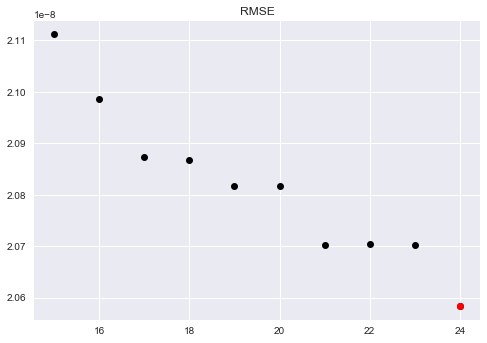

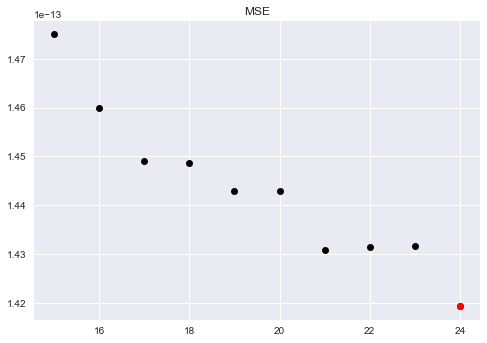

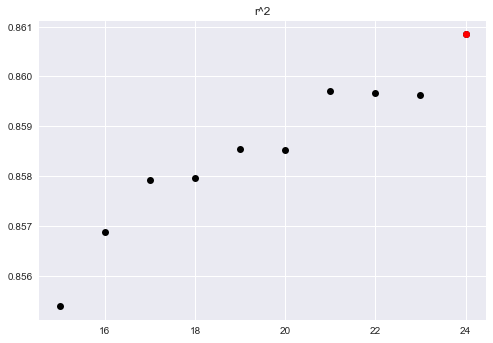

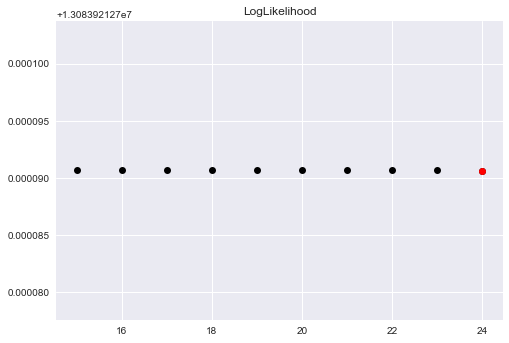

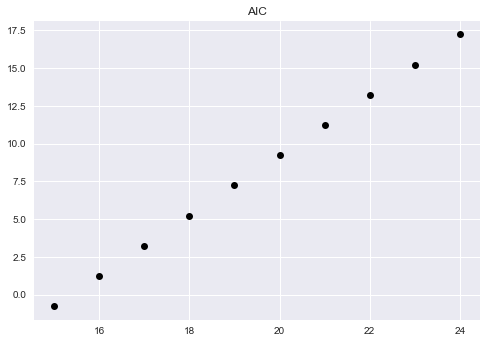

In [67]:
orders = np.arange(15, 25, 1)  # The orders to search
mse_res, rmse_res, r2_res, aic_res, loglik_res = sd.search_for_best_order(epochs,
                                                                          orders=orders, 
                                                                          plot=True)

In [68]:
best_order = orders[np.asarray(mse_res).argmin()]
print(best_order)

24


In [70]:
sim_data = sd.make_sim_data(epochs, baseline=(None, -0.1), order=17)

99 matching events found
1 projection items activated
0 bad epochs dropped


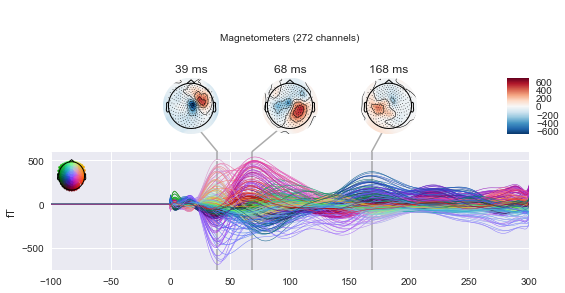

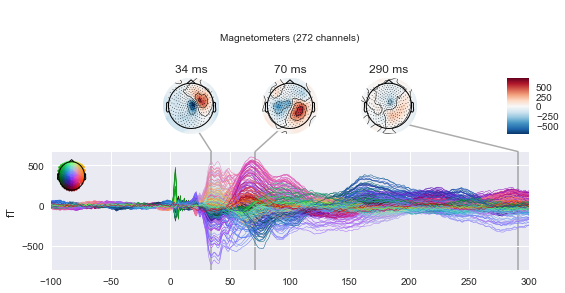

In [71]:
sim_data.average().plot_joint();
epochs.average().plot_joint();

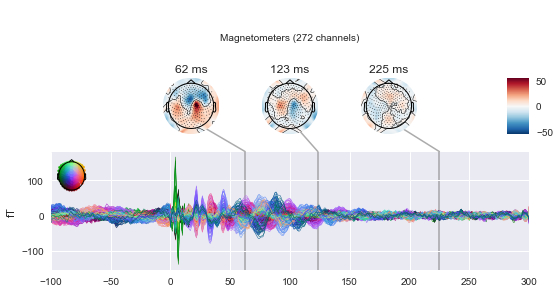

In [72]:
diff = mne.combine_evoked([epochs.average(), -sim_data.average()], weights="equal")
diff.plot_joint();